<a href="https://colab.research.google.com/github/VGokulPillai/Knowledge-Graph-Implementation_Dissertation-/blob/main/Knowledge_graph(with_coreferencing_and_spaCy).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install spacy==2.3.7

In [ ]:
import spacy
print(spacy.__version__)

In [ ]:
!python -m spacy download en

  Created wheel for en-core-web-sm: filename=en_core_web_sm-2.3.1-py3-none-any.whl size=12047105 sha256=18488ab397c37dc2b0e38c49aa6b7f5dbd8678830ece48a64de5de3bfb07810c
  Stored in directory: /root/.cache/pip/wheels/b7/0d/f0/7ecae8427c515065d75410989e15e5785dd3975fe06e795cd9
Successfully built en-core-web-sm
  Attempting uninstall: en-core-web-sm
    Found existing installation: en-core-web-sm 3.4.0
    Uninstalling en-core-web-sm-3.4.0:
      Successfully uninstalled en-core-web-sm-3.4.0
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')
✔ Linking successful
/usr/local/lib/python3.7/dist-packages/en_core_web_sm -->
/usr/local/lib/python3.7/dist-packages/spacy/data/en
You can now load the model via spacy.load('en')


In [ ]:
import spacy
nlp = spacy.load('en')

In [ ]:
!git clone https://github.com/huggingface/neuralcoref.git

In [ ]:
import os
os.chdir("/content/neuralcoref")
!pip install -r requirements.txt
!pip install -e .

In [ ]:
import logging;
logging.basicConfig(level=logging.INFO)

In [ ]:
import neuralcoref

INFO:neuralcoref:Getting model from https://s3.amazonaws.com/models.huggingface.co/neuralcoref/neuralcoref.tar.gz or cache
INFO:neuralcoref.file_utils:https://s3.amazonaws.com/models.huggingface.co/neuralcoref/neuralcoref.tar.gz not found in cache, downloading to /tmp/tmpaerk3jzz
100%|██████████| 40155833/40155833 [00:00<00:00, 45403864.34B/s]
INFO:neuralcoref.file_utils:copying /tmp/tmpaerk3jzz to cache at /root/.neuralcoref_cache/f46bc05a4bfba2ae0d11ffd41c4777683fa78ed357dc04a23c67137abf675e14.7d6f9a6fecf5cf09e74b65f85c7d6896b21decadb2554d486474f63b95ec4633
INFO:neuralcoref.file_utils:creating metadata file for /root/.neuralcoref_cache/f46bc05a4bfba2ae0d11ffd41c4777683fa78ed357dc04a23c67137abf675e14.7d6f9a6fecf5cf09e74b65f85c7d6896b21decadb2554d486474f63b95ec4633
INFO:neuralcoref.file_utils:removing temp file /tmp/tmpaerk3jzz
INFO:neuralcoref:extracting archive file /root/.neuralcoref_cache/f46bc05a4bfba2ae0d11ffd41c4777683fa78ed357dc04a23c67137abf675e14.7d6f9a6fecf5cf09e74b65f85c7d6

In [ ]:
import spacy
import neuralcoref

nlp = spacy.load("en_core_web_sm")
text = ("When Sebastian Thrun started working on self-driving cars at "
        "Google in 2007, few people outside of the company took him "
        "seriously. “I can tell you very senior CEOs of major American "
        "car companies would shake my hand and turn away because I wasn’t "
        "worth talking to,” said Thrun, in an interview with Recode earlier "
        "this week.")
doc = nlp(text)

# Analyze syntax
print("Noun phrases:", [chunk.text for chunk in doc.noun_chunks])
print("Verbs:", [token.lemma_ for token in doc if token.pos_ == "VERB"])

# Find named entities, phrases and concepts
for entity in doc.ents:
    print(entity.text, entity.label_)

Noun phrases: ['Sebastian Thrun', 'self-driving cars', 'Google', 'few people', 'the company', 'him', 'I', 'you', 'very senior CEOs', 'major American car companies', 'my hand', 'I', 'Thrun', 'an interview', 'Recode']
Verbs: ['start', 'work', 'drive', 'take', 'can', 'tell', 'would', 'shake', 'turn', 'talk', 'say']
Sebastian Thrun PERSON
Google ORG
2007 DATE
American NORP
Thrun PERSON
Recode LOC
earlier this week DATE


In [ ]:
import neuralcoref
neuralcoref.add_to_pipe(nlp)

In [ ]:
# Load your usual SpaCy model (one of SpaCy English models)
import spacy
nlp = spacy.load('en')

# Add neural coref to SpaCy's pipe
import neuralcoref
neuralcoref.add_to_pipe(nlp)

# You're done. You can now use NeuralCoref as you usually manipulate a SpaCy document annotations.
doc = nlp(u'My sister has a dog. She loves him.')

doc._.has_coref
doc._.coref_clusters

[My sister: [My sister, She], a dog: [a dog, him]]

In [ ]:
import pandas as pd
import re
import spacy
import neuralcoref
from tqdm import tqdm

nlp = spacy.load('en_core_web_sm')
neuralcoref.add_to_pipe(nlp)

def get_entity_pairs(text, coref=True):
    # preprocess text
    text = re.sub(r'\n+', '.', text)  # replace multiple newlines with period
    text = re.sub(r'\[\d+\]', ' ', text)  # remove reference numbers
    text = nlp(text)
    if coref:
        text = nlp(text._.coref_resolved)  # resolve coreference clusters

    def refine_ent(ent, sent):
        unwanted_tokens = (
            'PRON',  # pronouns
            'PART',  # particle
            'DET',  # determiner
            'SCONJ',  # subordinating conjunction
            'PUNCT',  # punctuation
            'SYM',  # symbol
            'X',  # other
        )
        ent_type = ent.ent_type_  # get entity type
        if ent_type == '':
            ent_type = 'NOUN_CHUNK'
            ent = ' '.join(str(t.text) for t in nlp(str(ent)) if t.pos_ not in unwanted_tokens and t.is_stop == False)
            
        elif ent_type in ('CARDINAL', 'ORDINAL') and str(ent).find(' ') == -1:
            refined = ''
            for i in range(len(sent) - ent.i):
                if ent.nbor(i).pos_ not in ('VERB', 'PUNCT'):
                    refined += ' ' + str(ent.nbor(i))
                else:
                    ent = refined.strip()
                    break

        return ent, ent_type

    sentences = [sent.string.strip() for sent in text.sents]  # split text into sentences
    ent_pairs = []
    for sent in sentences:
        sent = nlp(sent)
        spans = list(sent.ents) + list(sent.noun_chunks)  # collect nodes
        spans = spacy.util.filter_spans(spans)
        with sent.retokenize() as retokenizer:
            [retokenizer.merge(span, attrs={'tag': span.root.tag,
                                            'dep': span.root.dep}) for span in spans]
            
            
        deps = [token.dep_ for token in sent]

        # limit our example to simple sentences with one subject and object
        if (deps.count('obj') + deps.count('dobj')) != 1\
                or (deps.count('subj') + deps.count('nsubj')) != 1:
            continue

        for token in sent:
            if token.dep_ not in ('obj', 'dobj'):  # identify object nodes
                continue
            subject = [w for w in token.head.lefts if w.dep_
                       in ('subj', 'nsubj')]  # identify subject nodes
            if subject:
                subject = subject[0]
                # identify relationship by root dependency
                relation = [w for w in token.ancestors if w.dep_ == 'ROOT']
                if relation:
                    relation = relation[0]
                    # add adposition or particle to relationship
                    if relation.nbor(1).pos_ in ('ADP', 'PART'):
                        relation = ' '.join((str(relation), str(relation.nbor(1))))
                else:
                    relation = 'unknown'

                subject, subject_type = refine_ent(subject, sent)
                token, object_type = refine_ent(token, sent)

                ent_pairs.append([str(subject), str(relation), str(token), str(sent),
                                  str(subject_type), str(object_type)])

    ent_pairs = [sublist for sublist in ent_pairs
                          if not any(str(ent) == '' for ent in sublist)]
    pairs = pd.DataFrame(ent_pairs, columns=['subject', 'relation', 'object','sentence',
                                             'subject_type', 'object_type'])
    print('Entity pairs extracted:', str(len(ent_pairs)))

    return pairs

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


In [ ]:
# import wikipedia sentences
candidate_sentences = pd.read_csv("/content/Beatles_only - Sheet1.csv")

In [ ]:
cols = ['subject', 'relation', 'object','sentence','subject_type', 'object_type']
kg_new = pd.DataFrame(columns=cols)

for i in tqdm(candidate_sentences["sentence"]):
  df_temp = get_entity_pairs(i)
  kg_new = kg_new.append(df_temp, ignore_index=True)

  9%|▊         | 2/23 [00:00<00:02,  7.34it/s]

Entity pairs extracted: 1
Entity pairs extracted: 0


 22%|██▏       | 5/23 [00:00<00:01, 10.45it/s]

Entity pairs extracted: 0
Entity pairs extracted: 0
Entity pairs extracted: 0


 30%|███       | 7/23 [00:00<00:02,  7.78it/s]

Entity pairs extracted: 0
Entity pairs extracted: 1


 35%|███▍      | 8/23 [00:00<00:01,  7.88it/s]

Entity pairs extracted: 0


 43%|████▎     | 10/23 [00:01<00:02,  5.83it/s]

Entity pairs extracted: 0
Entity pairs extracted: 1


 57%|█████▋    | 13/23 [00:01<00:01,  6.10it/s]

Entity pairs extracted: 1
Entity pairs extracted: 0
Entity pairs extracted: 0


 65%|██████▌   | 15/23 [00:02<00:01,  7.40it/s]

Entity pairs extracted: 0
Entity pairs extracted: 1
Entity pairs extracted: 0


 78%|███████▊  | 18/23 [00:02<00:00,  7.87it/s]

Entity pairs extracted: 1
Entity pairs extracted: 0
Entity pairs extracted: 0


 91%|█████████▏| 21/23 [00:02<00:00,  8.90it/s]

Entity pairs extracted: 1
Entity pairs extracted: 0


100%|██████████| 23/23 [00:03<00:00,  7.54it/s]

Entity pairs extracted: 1
Entity pairs extracted: 0


In [ ]:
import pandas as pd
from difflib import SequenceMatcher
entityLinkTriples =[]
tempTriple_entities = ['', '', '']

def similar(a, b):
    return SequenceMatcher(None, a, b).ratio()

for i in range(len(kg_new['subject'])):
  for j in range(1,len(kg_new['subject'])):
    ratio = similar(kg_new['subject'][i],kg_new['subject'][j])
    if ratio > 0.5:
      kg_new['subject'][j] = kg_new['subject'][i]
      print(ratio,kg_new['subject'][i],kg_new['subject'][j])

   subject    relation                   object  \
0  Beatles      called                Quarrymen   
1  Beatles        sold      500 million records   
2  Beatles        play          the Cavern Club   
3  Beatles       begin             grueling gig   
4  Beatles  performing                 15 songs   
5  Beatles       begin  Beatles legendary stint   
6  Beatles        give          radio interview   
7  Beatles       begin     Beatles British tour   

                                            sentence subject_type object_type  
0                  The Beatles called The Quarrymen.   NOUN_CHUNK  NOUN_CHUNK  
1  The Beatles had sold more than 500 million rec...   NOUN_CHUNK  NOUN_CHUNK  
2  The Beatles with a lineup of Paul McCartney an...   NOUN_CHUNK         ORG  
3  The Beatles begin a grueling gig at Hamburg's ...   NOUN_CHUNK  NOUN_CHUNK  
4  The Beatles performing 15 songs at the label's...   NOUN_CHUNK  NOUN_CHUNK  
5  The Beatles begin The Beatles legendary stint ...   NOUN_

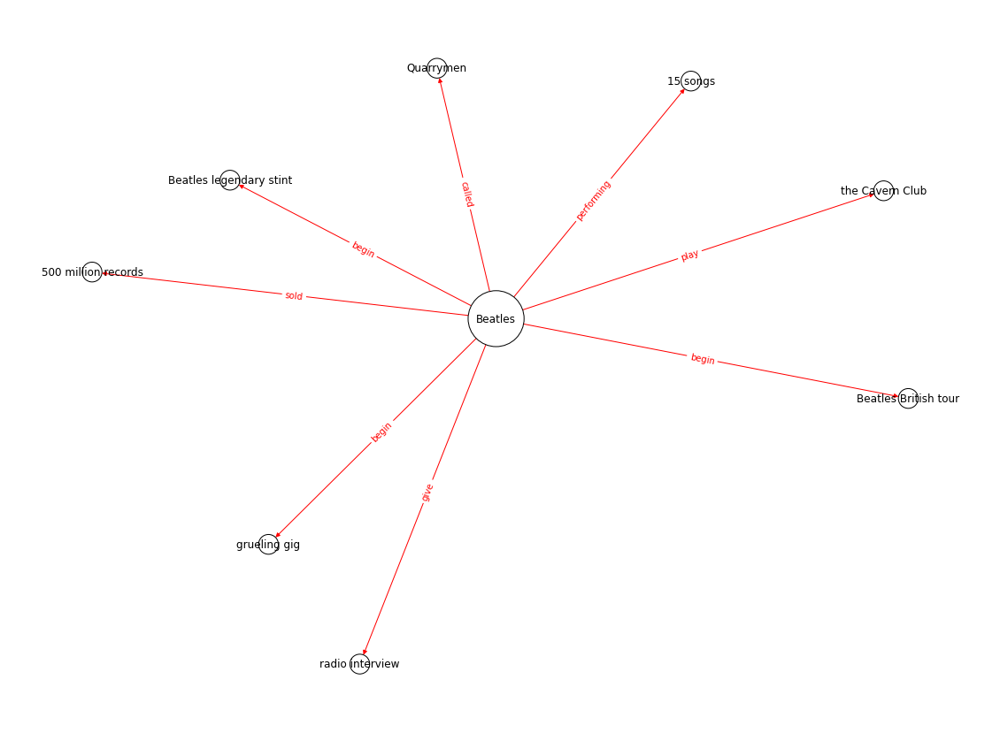

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

def draw_kg_v2(pairs):
    print(pairs)
    k_graph = nx.from_pandas_edgelist(pairs, 'subject', 'object',create_using=nx.MultiDiGraph())
    node_deg = nx.degree(k_graph)
    layout = nx.spring_layout(k_graph, k=0.5, iterations=20)
    plt.figure(figsize=(20,15))
    nx.draw_networkx(
        k_graph,
        node_size=[int(deg[1]) * 500 for deg in node_deg],
        pos=layout,
        edge_color='red',
        edgecolors='black',
        node_color='white',
        )
    labels = dict(zip(list(zip(pairs.subject, pairs.object)),pairs['relation'].tolist()))
    nx.draw_networkx_edge_labels(k_graph, pos=layout, edge_labels=labels,font_color='red')
    plt.axis('off')
    plt.show()
draw_kg_v2(kg_new)

In [ ]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import warnings

warnings.filterwarnings("ignore")
data = pd.read_csv("/content/drive/MyDrive/data.csv")
genre_data = pd.read_csv('/content/drive/MyDrive/data_by_genres.csv')
year_data = pd.read_csv('/content/drive/MyDrive/data_by_year.csv')


cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

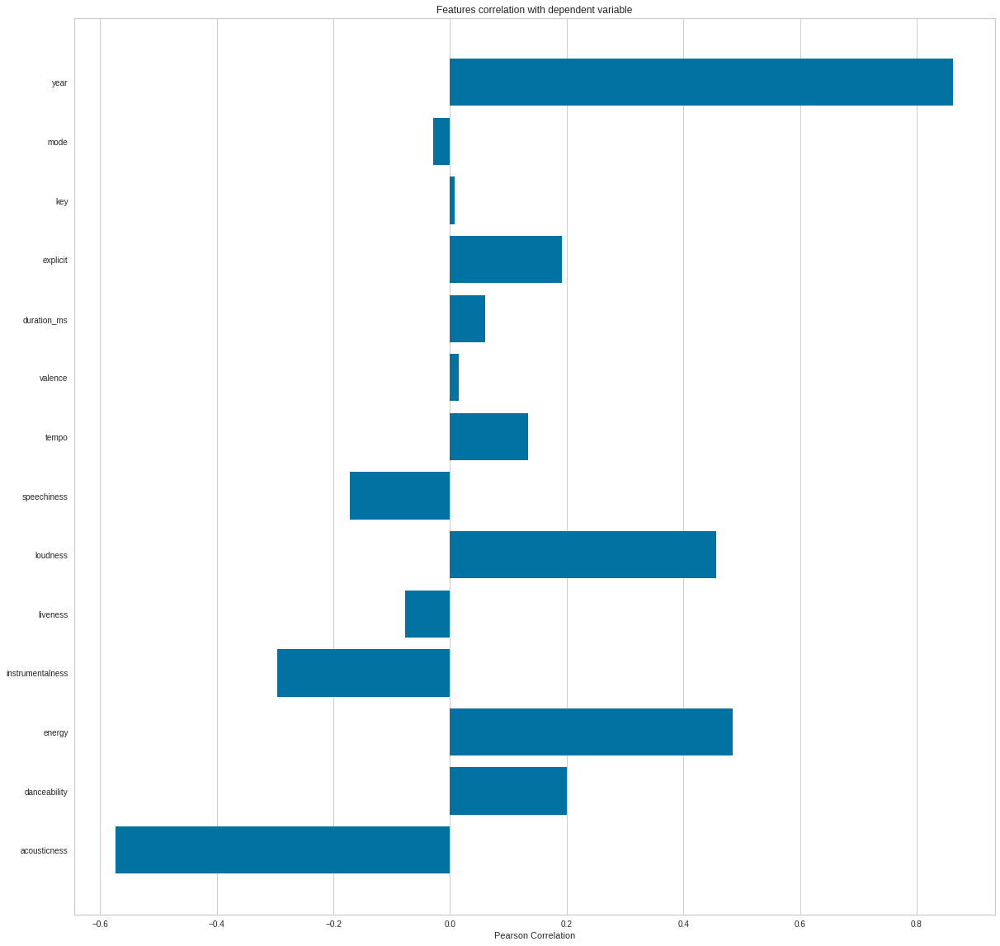

In [ ]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [ ]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

In [ ]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 170653 samples in 0.597s...
[t-SNE] Computed neighbors for 170653 samples in 587.046s...
[t-SNE] Computed conditional probabilities for sample 1000 / 170653
[t-SNE] Computed conditional probabilities for sample 2000 / 170653
[t-SNE] Computed conditional probabilities for sample 3000 / 170653
[t-SNE] Computed conditional probabilities for sample 4000 / 170653
[t-SNE] Computed conditional probabilities for sample 5000 / 170653
[t-SNE] Computed conditional probabilities for sample 6000 / 170653
[t-SNE] Computed conditional probabilities for sample 7000 / 170653
[t-SNE] Computed conditional probabilities for sample 8000 / 170653
[t-SNE] Computed conditional probabilities for sample 9000 / 170653
[t-SNE] Computed conditional probabilities for sample 10000 / 170653
[t-SNE] Computed conditional probabilities for sample 11000 / 170653
[t-SNE] Computed conditional probabilities for sample 12000 / 170653
[t-SNE] Computed conditional proba

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [ ]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [ ]:
!pip install spotipy

In [ ]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
SPOTIFY_CLIENT_ID = '6ea8b7249b5e465dbb0476284ed3222a'
SPOTIFY_CLIENT_SECRET = '7330946382e9405ba3984118468d7502'
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id= SPOTIFY_CLIENT_ID,client_secret= SPOTIFY_CLIENT_SECRET ))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] =  [name] 
    song_data['year'] =  [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [ ]:
pred_artists = recommend_songs([{'name': 'Here Comes the Sun', 'year':1969},###
                {'name': 'Come Together', 'year': 1969},
                {'name': 'Let It Be', 'year': 1970},
                {'name': 'hotel california', 'year': 1976}], data)

In [ ]:
kg_new['subject']

0                           Frontman Rivers Cuomo
1                                         Beatles
2                                            rest
3                                     the Beatles
4                                         Beatles
5                                       McCartney
6                                           group
7                               British rock band
8                                    Led Zeppelin
9                                         members
10                                          Ferry
11                 English rhythm blues rock band
12                      transplanted Texan singer
13                                            two
14    immediately online music magazine Pitchfork
15                               Elton John music
Name: subject, dtype: object